# TOV Evolution

In [1]:
import matplotlib.pyplot as plt
import numpy as np

import kuibit.cactus_scalars as cs
import kuibit.simdir as sd

from kuibit import grid_data as gd

In [2]:
#not perturbed
sim = sd.SimDir("/home/balza/simulations/TOV_test_1")
sim2 = sd.SimDir("/home/balza/simulations/TOV_test_2")
sim3 = sd.SimDir("/home/balza/simulations/TOV_test_3")

#perturbed
sim4 = sd.SimDir("/home/balza/simulations/TOV_pert_1")
sim5 = sd.SimDir("/home/balza/simulations/TOV_pert_2")
sim6 = sd.SimDir("/home/balza/simulations/TOV_pert_3")

In [102]:
#quantities that you can plot as a function of time
#unperturbed
timeseries = sim.timeseries
timeseries2 = sim2.timeseries
timeseries3 = sim3.timeseries

#perturbed
timeseries4 = sim4.timeseries
timeseries5 = sim5.timeseries
timeseries6 = sim6.timeseries

#print(timeseries)

In [103]:
#unperturbed
rho_max=timeseries.maximum.fields.rho #we are considernig the density for the plot
rho_max2=timeseries2.maximum.fields.rho
rho_max3=timeseries3.maximum.fields.rho

#perturbed
rho_max4=timeseries4.maximum.fields.rho
rho_max5=timeseries5.maximum.fields.rho
rho_max6=timeseries6.maximum.fields.rho

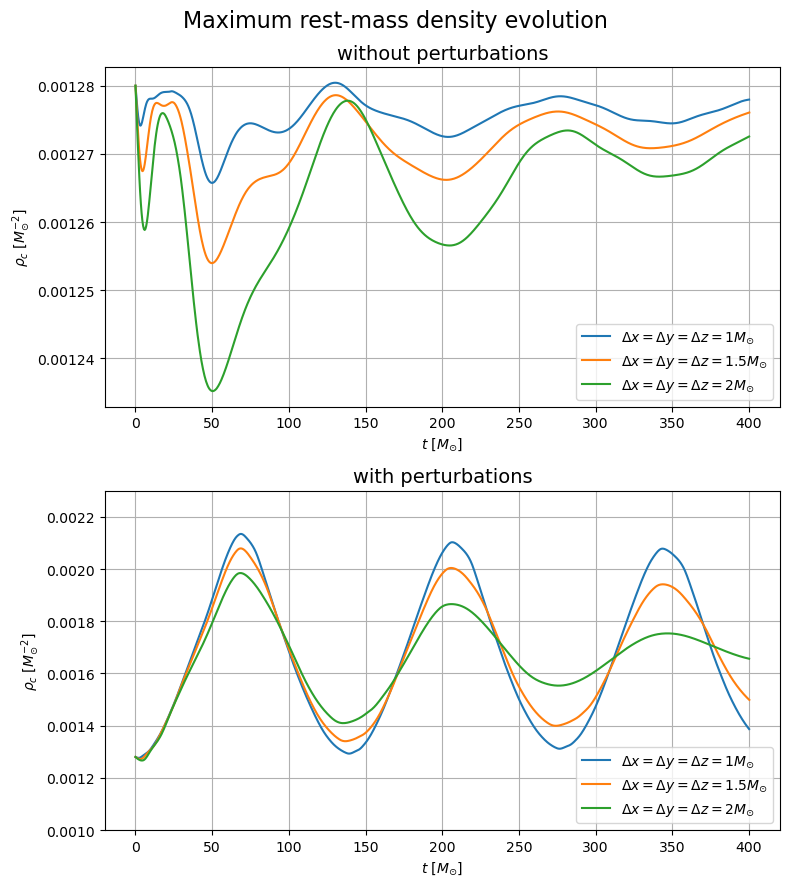

In [107]:
fig, ax = plt.subplots(2,1, figsize=(8,9))
ax[0].plot(rho_max2, label=r'$\Delta x = \Delta y = \Delta z = 1 M_{\odot}$')
ax[0].plot(rho_max3, label=r'$\Delta x = \Delta y = \Delta z = 1.5 M_{\odot}$')
ax[0].plot(rho_max, label=r'$\Delta x = \Delta y = \Delta z = 2 M_{\odot}$')
ax[1].plot(rho_max6, label=r'$\Delta x = \Delta y = \Delta z = 1 M_{\odot}$')
ax[1].plot(rho_max5, label=r'$\Delta x = \Delta y = \Delta z = 1.5 M_{\odot}$')
ax[1].plot(rho_max4, label=r'$\Delta x = \Delta y = \Delta z = 2M_{\odot}$')
ax[0].set_xlabel(r'$t$ [$M_{\odot}$]') #time = Mdot
ax[0].set_ylabel(r'$\rho_c$ [$M_{\odot}^{-2}$]') #mass/volume = Mdot^-2
ax[1].set_xlabel(r'$t$ [$M_{\odot}$]')
ax[1].set_ylabel(r'$\rho_c$ [$M_{\odot}^{-2}$]')
ax[1].set_ylim(0.0010,0.0023)
ax[0].legend()
ax[1].legend(loc='lower right')
fig.suptitle('Maximum rest-mass density evolution', fontsize=16)
ax[0].set_title('without perturbations', fontsize=14)
ax[1].set_title('with perturbations', fontsize=14)
plt.tight_layout()
[ax[i].grid(True) for i in range(2)]

plt.savefig('./TOV_maxRMevol.png')

plt.show()

In [24]:
gf = sim.gf
gf2 = sim2.gf
gf3 = sim3.gf

gf4 = sim4.gf
gf5 = sim5.gf
gf6 = sim6.gf

#print(gf)

In [25]:
vars2D = gf.xy #I look at the xy axis
vars2D_2 = gf2.xy
vars2D_3 = gf3.xy

vars2D_4 = gf4.xy
vars2D_5 = gf5.xy
vars2D_6 = gf6.xy
#print(vars2D)

In [26]:
rho = vars2D.fields.rho #and I consider the density
rho2 = vars2D_2.fields.rho
rho3 = vars2D_3.fields.rho

rho4 = vars2D_4.fields.rho
rho5 = vars2D_5.fields.rho
rho6 = vars2D_6.fields.rho

In [27]:
#print(rho.iterations)
#print(rho2.iterations)

In [28]:
#print(rho.available_times) #time corrisponding for each iteration

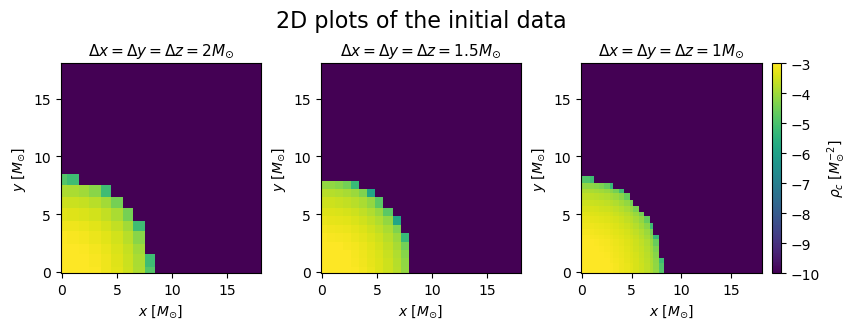

In [108]:
#inital data (SAME FOR NON PERTURBED AND PERTURBED CASE)

from mpl_toolkits.axes_grid1 import make_axes_locatable

small_grid = gd.UniformGrid([100, 100], x0=[0, 0], x1=[18,18]) #2D grid

rho_small = rho.read_on_grid(min(rho.iterations), small_grid) #interpolation of rho in this grid for a choosen iteration
rho_small_2 = rho2.read_on_grid(min(rho2.iterations), small_grid)
rho_small_3 = rho3.read_on_grid(min(rho3.iterations), small_grid)


fig, ax = plt.subplots(1,3, figsize=(9,3))

ax[0].pcolormesh(*rho_small.coordinates_meshgrid(), np.log10(rho_small.data_xyz), vmin=-10, vmax=-3)
ax[1].pcolormesh(*rho_small_3.coordinates_meshgrid(), np.log10(rho_small_3.data_xyz), vmin=-10, vmax=-3)
im1 = ax[2].pcolormesh(*rho_small_2.coordinates_meshgrid(), np.log10(rho_small_2.data_xyz), vmin=-10, vmax=-3)
divider = make_axes_locatable(ax[2])
cax = divider.append_axes("right", size="5%", pad=0.1)
fig.colorbar(im1, cax=cax, label=r'$\rho_c$ [$M_{\odot}^{-2}$]')

[ax[j].set_xlabel(r'$x$ [$M_{\odot}$]') for j in range(3)]
[ax[j].set_ylabel(r'$y$ [$M_{\odot}$]') for j in range(3)]
titles = [r'$\Delta x = \Delta y = \Delta z = 2 M_{\odot}$', 
          r'$\Delta x = \Delta y = \Delta z = 1.5 M_{\odot}$', 
          r'$\Delta x = \Delta y = \Delta z = 1 M_{\odot}$']
[ax[j].set_title(titles[j], fontsize=11) for j in range(3)]

fig.suptitle('2D plots of the initial data', fontsize=16)
#fig.suptitle('2D plots with perturbations', y=0.5)

plt.subplots_adjust(
    left=0.1,     # Left margin
    right=0.9,    # Right margin
    bottom=0.1,   # Bottom margin
    top=0.8,      # Top margin
    wspace=0.3,   # Horizontal space between subplots
    hspace=0.45    # Vertical space between subplots
)

#plt.tight_layout()
plt.savefig('./TOV_2D_in.png')
plt.show()

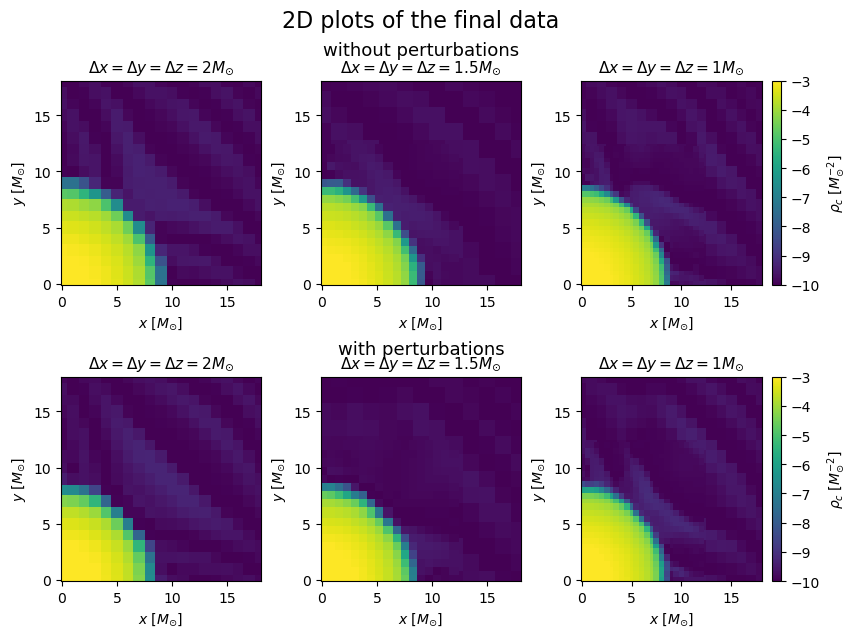

In [109]:
#final data

from mpl_toolkits.axes_grid1 import make_axes_locatable

small_grid = gd.UniformGrid([100, 100], x0=[0, 0], x1=[18,18]) #2D grid

rho_small = rho.read_on_grid(max(rho.iterations), small_grid) #interpolation of rho in this grid for a choosen iteration
rho_small_2 = rho2.read_on_grid(max(rho2.iterations), small_grid)
rho_small_3 = rho3.read_on_grid(max(rho3.iterations), small_grid)

rho_small_4 = rho4.read_on_grid(max(rho4.iterations), small_grid)
rho_small_5 = rho5.read_on_grid(max(rho5.iterations), small_grid)
rho_small_6 = rho6.read_on_grid(max(rho6.iterations), small_grid)


fig, ax = plt.subplots(2,3, figsize=(9,6.5))

ax[0,0].pcolormesh(*rho_small.coordinates_meshgrid(), np.log10(rho_small.data_xyz), vmin=-10, vmax=-3)
ax[0,1].pcolormesh(*rho_small_3.coordinates_meshgrid(), np.log10(rho_small_3.data_xyz), vmin=-10, vmax=-3)
im1 = ax[0,2].pcolormesh(*rho_small_2.coordinates_meshgrid(), np.log10(rho_small_2.data_xyz), vmin=-10, vmax=-3)
divider = make_axes_locatable(ax[0,2])
cax = divider.append_axes("right", size="5%", pad=0.1)
fig.colorbar(im1, cax=cax, label=r'$\rho_c$ [$M_{\odot}^{-2}$]')

ax[1,0].pcolormesh(*rho_small_4.coordinates_meshgrid(), np.log10(rho_small_4.data_xyz), vmin=-10, vmax=-3)
ax[1,1].pcolormesh(*rho_small_5.coordinates_meshgrid(), np.log10(rho_small_5.data_xyz), vmin=-10, vmax=-3)
im2 = ax[1,2].pcolormesh(*rho_small_6.coordinates_meshgrid(), np.log10(rho_small_6.data_xyz), vmin=-10, vmax=-3)
divider = make_axes_locatable(ax[1,2])
cax = divider.append_axes("right", size="5%", pad=0.1)
fig.colorbar(im2, cax=cax, label=r'$\rho_c$ [$M_{\odot}^{-2}$]')

[ax[i,j].set_xlabel(r'$x$ [$M_{\odot}$]') for i in range(2) for j in range(3)]
[ax[i,j].set_ylabel(r'$y$ [$M_{\odot}$]') for i in range(2) for j in range(3)]
titles = [r'$\Delta x = \Delta y = \Delta z = 2 M_{\odot}$', 
          r'$\Delta x = \Delta y = \Delta z = 1.5 M_{\odot}$', 
          r'$\Delta x = \Delta y = \Delta z = 1 M_{\odot}$']
[ax[i,j].set_title(titles[j], fontsize=11) for i in range(2) for j in range(3)]
y_positions = [0.93, 0.47]
Title = ['without perturbations','with perturbations']
[fig.text(
        0.5,                # x-position (center of the figure)
        y_positions[i],     # y-position
        Title[i],              # The title text
        ha='center',        # Horizontal alignment: center
        va='top',           # Vertical alignment: top
        fontsize=13,) for i in range(2)]
plt.subplots_adjust(
    left=0.1,     # Left margin
    right=0.9,    # Right margin
    bottom=0.1,   # Bottom margin
    top=0.87,      # Top margin
    wspace=0.3,   # Horizontal space between subplots
    hspace=0.45    # Vertical space between subplots
)
fig.suptitle('2D plots of the final data', fontsize=16)
#fig.suptitle('2D plots with perturbations', y=0.5)

#plt.tight_layout()
plt.savefig('./TOV_2D.png')
plt.show()

For TOV equations we need spherical symmetry and here we don't have a sphere! That's why we find perturbations, BUT THEY'R NOT PHYSICAL ONES
You see that the osillations smooths down because all the numerical methods has dissipations (as Lax-Frederic)

In [117]:
#for i in rho.iterations:
#    print(i)
#    rho_small = rho.read_on_grid(i, small_grid)
#    cf2=plt.contourf(*rho_small.coordinates_meshgrid(), np.log10(rho_small.data_xyz), vmin=-10, vmax=-3)
#    plt.savefig("frame_"+str(i)+".png")

## Not perturbed simulations

In [118]:
from IPython.display import HTML
import matplotlib.animation as animation
ims = []
fig,ax = plt.subplots()

for i in rho.iterations[0::1]:
    rho_small = rho.read_on_grid(i, small_grid)
    ax.set_xlabel(r'$x (M_\odot)$')
    ax.set_ylabel(r'$y (M_\odot)$')
    ax.set_aspect('equal')
    im = ax.pcolormesh(*rho_small.coordinates_meshgrid(), np.log10(rho_small.data_xyz), animated=True, vmin=-10, vmax=-3)
    plt.plot()
    #plt.colorbar(im)
    title = ax.text(0.5,1.05,('Time='+str(rho.available_times[i//2048])), size=plt.rcParams["axes.titlesize"], ha="center", transform=ax.transAxes)
    ims.append([im, title])
    plt.close()
    

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
HTML(ani.to_jshtml())

In [119]:
ims = []
fig,ax = plt.subplots()

for i in rho3.iterations[0::1]:
    rho_small_3 = rho3.read_on_grid(i, small_grid)
    ax.set_xlabel(r'$x (M_\odot)$')
    ax.set_ylabel(r'$y (M_\odot)$')
    ax.set_aspect('equal')
    im = ax.pcolormesh(*rho_small_3.coordinates_meshgrid(), np.log10(rho_small_3.data_xyz), animated=True, vmin=-10, vmax=-3)
    plt.plot()
    #plt.colorbar(im)
    title = ax.text(0.5,1.05,('Time='+str(rho3.available_times[i//2048])), size=plt.rcParams["axes.titlesize"], ha="center", transform=ax.transAxes)
    ims.append([im, title])
    plt.close()
    

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
HTML(ani.to_jshtml())

In [120]:
ims = []
fig,ax = plt.subplots()

for i in rho2.iterations[0::1]:
    rho_small_2 = rho2.read_on_grid(i, small_grid)
    ax.set_xlabel(r'$x (M_\odot)$')
    ax.set_ylabel(r'$y (M_\odot)$')
    ax.set_aspect('equal')
    im = ax.pcolormesh(*rho_small_2.coordinates_meshgrid(), np.log10(rho_small_2.data_xyz), animated=True, vmin=-10, vmax=-3)
    plt.plot()
    #plt.colorbar(im)
    title = ax.text(0.5,1.05,('Time='+str(rho2.available_times[i//2048])), size=plt.rcParams["axes.titlesize"], ha="center", transform=ax.transAxes)
    ims.append([im, title])
    plt.close()
    

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
HTML(ani.to_jshtml())

## Perturbed Simulations

In [121]:
ims = []
fig,ax = plt.subplots()

for i in rho4.iterations[0::1]:
    rho_small_4 = rho4.read_on_grid(i, small_grid)
    ax.set_xlabel(r'$x (M_\odot)$')
    ax.set_ylabel(r'$y (M_\odot)$')
    ax.set_aspect('equal')
    im = ax.pcolormesh(*rho_small_4.coordinates_meshgrid(), np.log10(rho_small_4.data_xyz), animated=True, vmin=-10, vmax=-3)
    plt.plot()
    #plt.colorbar(im)
    title = ax.text(0.5,1.05,('Time='+str(rho4.available_times[i//2048])), size=plt.rcParams["axes.titlesize"], ha="center", transform=ax.transAxes)
    ims.append([im, title])
    plt.close()
    

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
HTML(ani.to_jshtml())

In [106]:
ims = []
fig,ax = plt.subplots()

for i in rho5.iterations[0::1]:
    rho_small_5 = rho5.read_on_grid(i, small_grid)
    ax.set_xlabel(r'$x (M_\odot)$')
    ax.set_ylabel(r'$y (M_\odot)$')
    ax.set_aspect('equal')
    im = ax.pcolormesh(*rho_small_5.coordinates_meshgrid(), np.log10(rho_small_5.data_xyz), animated=True, vmin=-10, vmax=-3)
    plt.plot()
    #plt.colorbar(im)
    title = ax.text(0.5,1.05,('Time='+str(rho5.available_times[i//2048])), size=plt.rcParams["axes.titlesize"], ha="center", transform=ax.transAxes)
    ims.append([im, title])
    plt.close()
    

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
HTML(ani.to_jshtml())

In [122]:
ims = []
fig,ax = plt.subplots()

for i in rho6.iterations[0::1]:
    rho_small_6 = rho6.read_on_grid(i, small_grid)
    ax.set_xlabel(r'$x (M_\odot)$')
    ax.set_ylabel(r'$y (M_\odot)$')
    ax.set_aspect('equal')
    im = ax.pcolormesh(*rho_small_6.coordinates_meshgrid(), np.log10(rho_small_6.data_xyz), animated=True, vmin=-10, vmax=-3)
    plt.plot()
    #plt.colorbar(im)
    title = ax.text(0.5,1.05,('Time='+str(rho6.available_times[i//2048])), size=plt.rcParams["axes.titlesize"], ha="center", transform=ax.transAxes)
    ims.append([im, title])
    plt.close()
    

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
HTML(ani.to_jshtml())